

## Common preprocessing steps:
### a. Quality control (Inspecting and cleaning the data):
This part typically includes reading the file, inspecting various aspects of the data such as its size/shape, presence of NaN values, and understanding the type of data.
For better undrestanding the  data histogram always helps.
After inspecting the data, the next step is to clean it, which involves handling missing values, removing duplicates, or addressing any other data quality issues that may be present.

### b. Normalizing and Scaling:
is a common preprocessing step that aims to adjust data to a standard range or distribution. It is performed to address differences in magnitudes or scales between different features or variables in the data. Normalization is particularly important when comparing or combining variables that have different units or ranges of values. 

### c. Feature selection:

Feature selection involves identifying and selecting a subset of relevant features from the dataset. This step is beneficial when dealing with high-dimensional data, as it helps reduce noise and computational complexity, leading to improved clustering results. By selecting the most informative features, we can focus on the essential aspects of the data, leading to more effective clustering outcomes.
To find the most informative features, we have to examine the correlation and skew of the relevant variables (non-categorical variables). And then, apply feature scalling.
Finally, the pairplot of the scalled data to see any distinghion on the data, that could be good for classification.


### d. Dimensionality reduction:
Dimensionality reduction techniques, such as principal component analysis (PCA) or t-distributed stochastic neighbor embedding (t-SNE), are used to reduce the dimensionality of the data while retaining its key structure. This step helps visualize and analyze the data effectively by reducing noise and highlighting underlying patterns.

These preprocessing steps should be executed to ensure the data is of high quality, comparable, and suitable for downstream analysis. However, the specific execution may vary depending on the dataset and analysis goals. For example, if the dataset is already preprocessed and normalized, one may skip those steps and proceed directly to dimensionality reduction and clustering analysis.




### Clustering Techniques:
 
There are many method of classification. For instance: K-means, agglomerative, Randomforest Classifier are named in this toturial.

The number of clusters depends on us, and we have to check how many cluster satisfied our expectation.
For example in k-mean clustering a plot between number of clusters and inertia can be halpful. Or in agglomerative model we can use dendrogram.


### Other clustering techniques

**Spectral clustering** 

**DBSCAN**


------


Fatemeh and I collaborated on this assignment.

## Clustering on a breat cancer dataset

In [28]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler



### Preprocessing

In [11]:

# Read the breast cancer dataset
data = pd.read_csv(r'../Data/breast-cancer.csv')
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [12]:
data['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [13]:
# Cleaning and modifying the data
data = data.drop('id',axis=1)

# Mapping Benign to 0 and Malignant to 1 
data['diagnosis'] = data['diagnosis'].map({'M':1,'B':0})

In [14]:
data.dtypes

diagnosis                    int64
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst            float64
concave points_worst

In [21]:
float_columns = [x for x in data.columns if x not in ['diagnosis']]

# The correlation matrix
corr_mat = data[float_columns].corr()

# Strip out the diagonal values for the next step
for x in range(len(float_columns)):
    corr_mat.iloc[x,x] = 0.0
    
corr_mat

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,0.000000,0.318346,0.998017,0.999465,0.152087,0.492571,0.653618,0.797439,0.128959,-0.345094,...,0.975933,0.299314,0.971613,0.975917,0.105461,0.436392,0.549617,0.741947,0.168476,0.000531
texture_mean,0.318346,0.000000,0.322669,0.319679,-0.023389,0.237095,0.306604,0.293868,0.071401,-0.076457,...,0.348637,0.912045,0.353002,0.347764,0.077503,0.276816,0.302070,0.295316,0.104075,0.118702
perimeter_mean,0.998017,0.322669,0.000000,0.997281,0.188234,0.541800,0.690108,0.823452,0.161561,-0.297124,...,0.976416,0.305471,0.976866,0.976047,0.136902,0.480721,0.587564,0.770810,0.194044,0.046200
area_mean,0.999465,0.319679,0.997281,0.000000,0.140885,0.481178,0.647029,0.789748,0.119882,-0.356358,...,0.977022,0.301981,0.972417,0.978046,0.098204,0.429506,0.545970,0.736811,0.162359,-0.006294
smoothness_mean,0.152087,-0.023389,0.188234,0.140885,0.000000,0.663873,0.524513,0.555805,0.557775,0.585325,...,0.201604,0.036072,0.225814,0.188693,0.805324,0.481421,0.436713,0.503053,0.395056,0.501116
compactness_mean,0.492571,0.237095,0.541800,0.481178,0.663873,0.000000,0.887457,0.834434,0.600340,0.563320,...,0.531776,0.249309,0.583683,0.517857,0.571112,0.878121,0.824687,0.820806,0.506257,0.691042
concavity_mean,0.653618,0.306604,0.690108,0.647029,0.524513,0.887457,0.000000,0.925341,0.498109,0.333889,...,0.678598,0.306762,0.716120,0.670378,0.457063,0.778127,0.894757,0.873077,0.411063,0.523907
concave points_mean,0.797439,0.293868,0.823452,0.789748,0.555805,0.834434,0.925341,0.000000,0.462297,0.167030,...,0.817425,0.294542,0.839650,0.808195,0.456938,0.689409,0.772976,0.914746,0.377154,0.374532
symmetry_mean,0.128959,0.071401,0.161561,0.119882,0.557775,0.600340,0.498109,0.462297,0.000000,0.479810,...,0.173206,0.090651,0.202381,0.161543,0.426675,0.472821,0.425368,0.430297,0.704904,0.439321
fractal_dimension_mean,-0.345094,-0.076457,-0.297124,-0.356358,0.585325,0.563320,0.333889,0.167030,0.479810,0.000000,...,-0.286202,-0.051167,-0.240258,-0.300993,0.505474,0.454654,0.327544,0.175167,0.330029,0.769124


In [22]:
# see with features are highly correlated
# Pairwise maximal correlations
corr_mat.abs().idxmax()

radius_mean                              area_mean
texture_mean                         texture_worst
perimeter_mean                         radius_mean
area_mean                              radius_mean
smoothness_mean                   smoothness_worst
compactness_mean                    concavity_mean
concavity_mean                 concave points_mean
concave points_mean                 concavity_mean
symmetry_mean                       symmetry_worst
fractal_dimension_mean     fractal_dimension_worst
radius_se                             perimeter_se
texture_se                           texture_worst
perimeter_se                             radius_se
area_se                                  radius_se
smoothness_se                 fractal_dimension_se
compactness_se                        concavity_se
concavity_se                        compactness_se
concave points_se                     concavity_se
symmetry_se                          symmetry_mean
fractal_dimension_se           

In [23]:
# how much are they correlated? Can we eliminate certain features based on high correlations
corr_mat.abs().max()

radius_mean                0.999465
texture_mean               0.912045
perimeter_mean             0.998017
area_mean                  0.999465
smoothness_mean            0.805324
compactness_mean           0.887457
concavity_mean             0.925341
concave points_mean        0.925341
symmetry_mean              0.704904
fractal_dimension_mean     0.769124
radius_se                  0.960671
texture_se                 0.457216
perimeter_se               0.960671
area_se                    0.951101
smoothness_se              0.428325
compactness_se             0.822292
concavity_se               0.822292
concave points_se          0.784603
symmetry_se                0.449103
fractal_dimension_se       0.802681
radius_worst               0.998996
texture_worst              0.912045
perimeter_worst            0.994359
area_worst                 0.998996
smoothness_worst           0.805324
compactness_worst          0.902511
concavity_worst            0.902511
concave points_worst       0

Most of them are correlated.
And an examination of the skew values in anticipation of transformations.

In [24]:
# .skew 0: no skew, + right skew, - left skew, look for above .75 
skew_columns = (data[float_columns]
                .skew()
                .sort_values(ascending=False))

skew_columns = skew_columns.loc[skew_columns > 0.75]
skew_columns

concavity_se               4.231738
fractal_dimension_se       3.874373
smoothness_se              2.283394
symmetry_se                2.135874
compactness_se             1.816278
radius_se                  1.713417
fractal_dimension_worst    1.558559
concave points_se          1.399869
fractal_dimension_mean     1.272294
concavity_mean             1.206982
symmetry_worst             1.152984
concave points_mean        1.083180
compactness_worst          1.048729
compactness_mean           1.043195
perimeter_se               1.025375
area_se                    0.847298
dtype: float64

Perform log transform on skewed columns


In [25]:
for col in skew_columns.index.tolist():
    data[col] = np.log1p(data[col])

Perform feature scaling.

In [26]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
data[float_columns] = sc.fit_transform(data[float_columns])

data.head(4)

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,1.138030,-2.073335,1.281628,1.130319,1.568466,3.036642,2.488680,2.444989,2.217515,...,1.764045,-1.359293,2.022158,1.794344,1.307686,2.356825,2.003224,2.296076,2.623019,1.940834
1,1,1.711783,-0.353632,1.597721,1.713327,-0.826962,-0.475107,0.043459,0.593328,0.001392,...,1.706795,-0.369203,1.502321,1.737118,-0.375612,-0.388840,-0.077623,1.087084,-0.215520,0.302723
2,1,1.524183,0.456187,1.509470,1.511457,0.942210,1.094900,1.411503,2.005368,0.939685,...,1.490832,-0.023974,1.362620,1.493444,0.527407,1.176681,0.929353,1.955000,1.192607,0.221603
3,1,-0.774335,0.253732,-0.550424,-0.843470,3.283553,3.131393,1.892855,1.466971,2.867383,...,-0.179580,0.133984,-0.130272,-0.494860,3.394275,3.141062,1.907919,2.175786,5.105123,4.705257


Finally, the pairplot of the transformed and scaled features.

In [27]:
sns.set_context('notebook')
sns.pairplot(data, 
             hue='diagnosis');

## Dimensionality reduction - PCA


As the good features are many. We have to reduce the dimension of dataset first. We can start by using PCA. We have to check the explained variance per component.

In [76]:
from sklearn.decomposition import PCA

data_normalized = StandardScaler().fit_transform(data[float_columns])

pca = PCA(n_components=10)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc1', 'pc2', 'pc3','pc4','pc5','pc6','pc7','pc8','pc9','pc10'])
principalDf.head()



,pc1,pc2,pc3,pc4,pc5,pc6,pc7,pc8,pc9,pc10
0,8.674863,2.091484,-1.844084,-2.949247,-1.786451,1.248680,-1.804540,0.059470,0.167795,-0.858161
1,2.518074,-3.766229,-0.278477,-1.291186,0.107187,0.001240,-0.661340,0.454756,-0.055597,0.832100
2,5.971780,-1.100324,-0.397807,-0.949264,-0.587262,0.477531,0.245999,0.116792,-0.268687,0.262505
3,6.923893,9.617466,-3.170307,0.783332,-2.683753,2.623691,-0.936759,1.217989,1.568651,-1.142060
4,4.116705,-1.795063,1.193860,-3.297419,-0.182818,-1.404678,0.493619,0.657240,-0.244033,0.408437


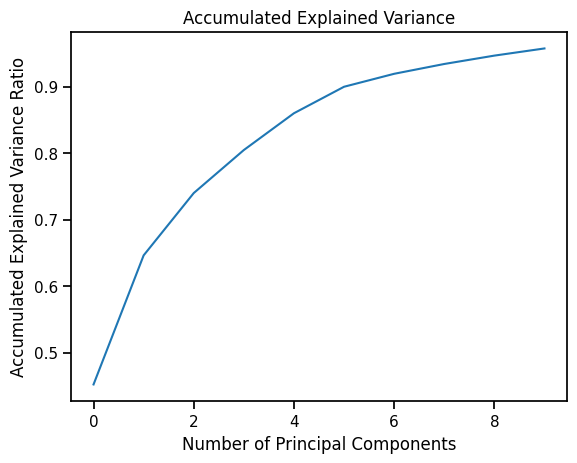

In [50]:
explained_variance_ratio_cumsum = np.cumsum(pca.explained_variance_ratio_)
plt.plot(explained_variance_ratio_cumsum)
plt.title('Accumulated Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Accumulated Explained Variance Ratio')
plt.show()


Two first principle explaines only 70% of the data, As we need more accuracy so we have to choose more component like 8 that we have almoset 90% of the data. So this method is not appropriate for visualization of clustering the data.

## tSNE

Let's move on and try tSNE - a method that is useful for visualization of high-dimensional datasets as it results in a 2D projection of the high dimensional datast. 

In [59]:
#Creating a 2D visualization to visualize the clusters
from sklearn.manifold import TSNE
tsne = TSNE(verbose=1, perplexity=40, n_iter= 4000)
Y = tsne.fit_transform(X)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 569 samples in 0.001s...
[t-SNE] Computed neighbors for 569 samples in 0.032s...
[t-SNE] Computed conditional probabilities for sample 569 / 569
[t-SNE] Mean sigma: 1.636663
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.145290
[t-SNE] KL divergence after 1150 iterations: 0.898441


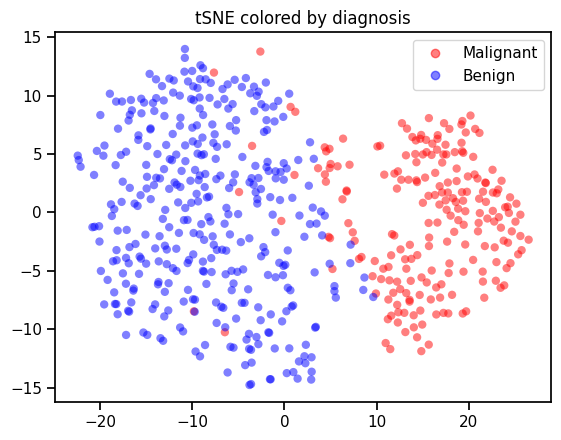

In [60]:
# Map diagnosis categories to colors
diagnosis_color_map = {1: 'red', 0: 'blue'}  # 1: Malignant, 0: Benign

# Scatter plot with custom color mapping
for diagnosis, color in diagnosis_color_map.items():
    plt.scatter(Y[data['diagnosis'] == diagnosis, 0], Y[data['diagnosis'] == diagnosis, 1],
                c=color, label=('Malignant' if diagnosis == 1 else 'Benign'), edgecolor='None', alpha=0.5)

plt.title('tSNE colored by diagnosis')

# Create custom legend
legend_elements = [plt.Line2D([0], [0], marker='o', color=color, label=('Malignant' if diagnosis == 1 else 'Benign'), linestyle='', alpha=0.5)
                   for diagnosis, color in diagnosis_color_map.items()]
plt.legend(handles=legend_elements)

plt.show()


t-SNE is a stochastic algorithm, meaning it involves randomness during its execution.
This randomness can cause the t-SNE results to be slightly different each time you run the algorithm on the same data.
To make the results reproducible, you can set a random seed before running t-SNE.
Setting the random seed ensures that t-SNE uses the same randomization each time you run it, leading to consistent results.
To set the random seed in your code, you can use the random_state parameter in the TSNE class:

In [77]:
from sklearn.manifold import TSNE

# Set the random seed to 42 (you can use any integer value)
tsne = TSNE(verbose=1, perplexity=40, n_iter=4000, random_state=42)
tsne_fitted = tsne.fit_transform(data_normalized)


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 569 samples in 0.001s...
[t-SNE] Computed neighbors for 569 samples in 0.036s...
[t-SNE] Computed conditional probabilities for sample 569 / 569
[t-SNE] Mean sigma: 1.636663
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.143295
[t-SNE] KL divergence after 2250 iterations: 0.900230


By using the same seed, you should get the same t-SNE results each time you run the code with the same data and parameters.

In [82]:
### BEGIN SOLUTION
# Create and fit a range of models store cliuster numbers, inertia and model is series object
km_list = list()

for clust in range(1,21):
    km = KMeans(n_clusters=clust, random_state=42, n_init=10)
    km = km.fit(tsne_fitted)

    
    km_list.append(pd.Series({'clusters': clust, 
                              'inertia': km.inertia_,
                              'model': km}))

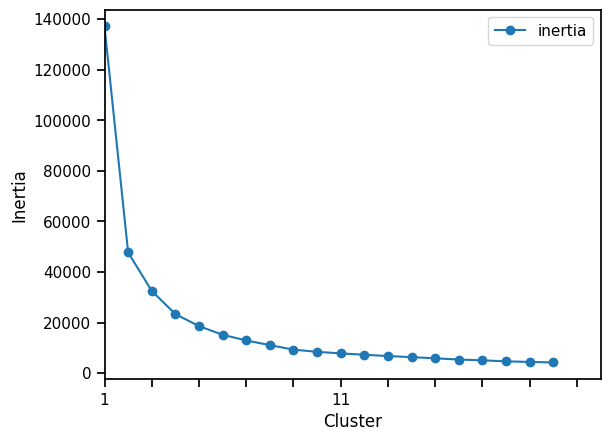

In [83]:
plot_data = (pd.concat(km_list, axis=1)
             .T
             [['clusters','inertia']]
             .set_index('clusters'))

ax = plot_data.plot(marker='o',ls='-')
ax.set_xticks(range(0,21,2))
ax.set_xlim(0,21)
ax.set(xlabel='Cluster', ylabel='Inertia');
### END SOLUTION

Now it time for decision.
We assume that there are two cluster, one for benign and one for malignant. Of course in further investigation maybe can be considered more than one clustering for malignant samples.

## K-means clustering

c:\Users\LENOVO\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


(-24.182816600799562,
 30.404177761077882,
 -13.423967027664185,
 18.49444260597229)

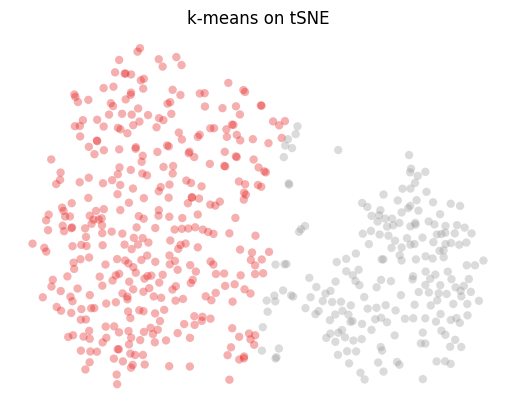

In [84]:
#Cluster using k-means

# K-means on original data
from sklearn.cluster import KMeans
# kmns = KMeans(n_clusters=2, init='k-means++')
# kY = kmns.fit_predict(data_normalized)

# plt.subplot()
# plt.scatter(data_normalized[:,0],data_normalized[:,1],  c=kY, cmap = "Set1", edgecolor = "None", alpha=0.35)
# plt.title('k-means on data')
# plt.axis('off')



# K-means on tSNE results
kmns = KMeans(n_clusters=2, init='k-means++')
kY = kmns.fit_predict(tsne_fitted)

plt.subplot()
plt.scatter(tsne_fitted[:,0],tsne_fitted[:,1],  c=kY, cmap = "Set1", edgecolor = "None", alpha=0.35)
plt.title('k-means on tSNE')
plt.axis('off')





----